# Classification using KNN

The given dataset is composed of a range of biomedical voice measurements from 31 people, 23 with Parkinson's disease (PD). Each column in the table is a particular voice measure, and each row corresponds one of 195 voice recording from these individuals ("name" column). The main aim of the data is to discriminate healthy people from those with Parkinson's Disease, according to "status" column which is set to 0 for healthy and 1 for PD.  Dataset can be downloaded from below link.

https://archive.ics.uci.edu/ml/datasets/parkinsons

Create classification model using KNN.  Identify the optimum no of neighbors and dimensions for your model.

## Library imports

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.simplefilter("ignore")

## Load Dataset and Validate the Data load

In [2]:
# load the data
parkinsons = pd.read_csv("dataset/parkinsons.data")

# Check the data load
parkinsons.head()

,name,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
0,phon_R01_S01_1,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,...,0.06545,0.02211,21.033,1,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,phon_R01_S01_2,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,...,0.09403,0.01929,19.085,1,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,phon_R01_S01_3,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,...,0.08270,0.01309,20.651,1,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,phon_R01_S01_4,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,...,0.08771,0.01353,20.644,1,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,phon_R01_S01_5,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,...,0.10470,0.01767,19.649,1,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335


In [3]:
# Check for overall data structure
parkinsons.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 195 entries, 0 to 194
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   name              195 non-null    object 
 1   MDVP:Fo(Hz)       195 non-null    float64
 2   MDVP:Fhi(Hz)      195 non-null    float64
 3   MDVP:Flo(Hz)      195 non-null    float64
 4   MDVP:Jitter(%)    195 non-null    float64
 5   MDVP:Jitter(Abs)  195 non-null    float64
 6   MDVP:RAP          195 non-null    float64
 7   MDVP:PPQ          195 non-null    float64
 8   Jitter:DDP        195 non-null    float64
 9   MDVP:Shimmer      195 non-null    float64
 10  MDVP:Shimmer(dB)  195 non-null    float64
 11  Shimmer:APQ3      195 non-null    float64
 12  Shimmer:APQ5      195 non-null    float64
 13  MDVP:APQ          195 non-null    float64
 14  Shimmer:DDA       195 non-null    float64
 15  NHR               195 non-null    float64
 16  HNR               195 non-null    float64
 1

In [4]:
# Check for summary statistics

parkinsons.describe()

,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,MDVP:Shimmer(dB),...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
count,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,...,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000,195.000000
mean,154.228641,197.104918,116.324631,0.006220,0.000044,0.003306,0.003446,0.009920,0.029709,0.282251,...,0.046993,0.024847,21.885974,0.753846,0.498536,0.718099,-5.684397,0.226510,2.381826,0.206552
std,41.390065,91.491548,43.521413,0.004848,0.000035,0.002968,0.002759,0.008903,0.018857,0.194877,...,0.030459,0.040418,4.425764,0.431878,0.103942,0.055336,1.090208,0.083406,0.382799,0.090119
min,88.333000,102.145000,65.476000,0.001680,0.000007,0.000680,0.000920,0.002040,0.009540,0.085000,...,0.013640,0.000650,8.441000,0.000000,0.256570,0.574282,-7.964984,0.006274,1.423287,0.044539
25%,117.572000,134.862500,84.291000,0.003460,0.000020,0.001660,0.001860,0.004985,0.016505,0.148500,...,0.024735,0.005925,19.198000,1.000000,0.421306,0.674758,-6.450096,0.174351,2.099125,0.137451
50%,148.790000,175.829000,104.315000,0.004940,0.000030,0.002500,0.002690,0.007490,0.022970,0.221000,...,0.038360,0.011660,22.085000,1.000000,0.495954,0.722254,-5.720868,0.218885,2.361532,0.194052
75%,182.769000,224.205500,140.018500,0.007365,0.000060,0.003835,0.003955,0.011505,0.037885,0.350000,...,0.060795,0.025640,25.075500,1.000000,0.587562,0.761881,-5.046192,0.279234,2.636456,0.252980
max,260.105000,592.030000,239.170000,0.033160,0.000260,0.021440,0.019580,0.064330,0.119080,1.302000,...,0.169420,0.314820,33.047000,1.000000,0.685151,0.825288,-2.434031,0.450493,3.671155,0.527367


In [5]:
# Check for any missing values in the dataset
parkinsons.isna().sum()

name                0
MDVP:Fo(Hz)         0
MDVP:Fhi(Hz)        0
MDVP:Flo(Hz)        0
MDVP:Jitter(%)      0
MDVP:Jitter(Abs)    0
MDVP:RAP            0
MDVP:PPQ            0
Jitter:DDP          0
MDVP:Shimmer        0
MDVP:Shimmer(dB)    0
Shimmer:APQ3        0
Shimmer:APQ5        0
MDVP:APQ            0
Shimmer:DDA         0
NHR                 0
HNR                 0
status              0
RPDE                0
DFA                 0
spread1             0
spread2             0
D2                  0
PPE                 0
dtype: int64

There are no missing values

## Exploratory Data Analysis

### The target variable - "status"

1    147
0     48
Name: status, dtype: int64


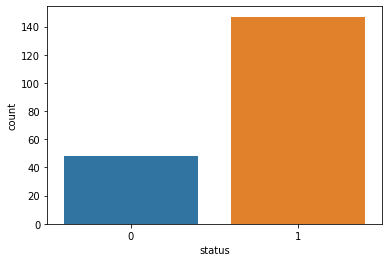

In [6]:
sns.countplot(x='status', data=parkinsons);

# Distribution of the split
print(parkinsons['status'].value_counts())

The above is an unbalanced dataset with more number of Parkinsons patient, rather than Healthy Patients

In [7]:
# Name is a categorical column and every instance of the row is unique, we would not be using it in our modeling, 
# so dropping this variable

parkinsons =  parkinsons.drop(labels=['name'], axis=1)

<AxesSubplot:>

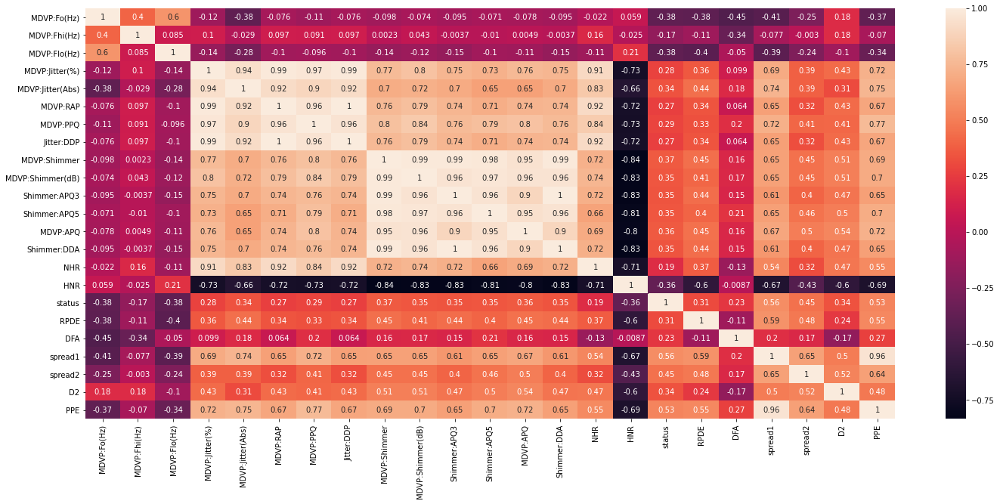

In [8]:
# We will build a correlation heatmap to analyse certain dependencies
plt.figure(figsize=(24, 10))
sns.heatmap(parkinsons.corr(), annot=True)

From the above correlation table, we see there are lot of attributes which are positively or negatively correlated with each other

### Highly Correlated features should be dropped from Modelling as it may worsen the model due to multicollinearity issues

In [9]:
# We will identify qll features which are either positively or negatively correlated with a coefficient greater than 0.7 (highly correlated ones)

corr_features = set()
corr_matrix = parkinsons.corr()

for i in range(len(corr_matrix.columns)):
    for j in range(i):
        if abs(corr_matrix.iloc[i, j]) > 0.7:
            colname = corr_matrix.columns[i]
            corr_features.add(colname)

In [10]:
print(corr_features)

{'Jitter:DDP', 'Shimmer:DDA', 'HNR', 'MDVP:APQ', 'Shimmer:APQ5', 'MDVP:PPQ', 'spread1', 'MDVP:Jitter(Abs)', 'MDVP:Shimmer(dB)', 'MDVP:Shimmer', 'Shimmer:APQ3', 'MDVP:RAP', 'PPE', 'NHR'}


In [11]:
# Removal of Correlated features

parkinsons_reduced = parkinsons.drop(labels=corr_features, axis=1)
parkinsons_reduced.head()

,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),status,RPDE,DFA,spread2,D2
0,119.992,157.302,74.997,0.00784,1,0.414783,0.815285,0.266482,2.301442
1,122.400,148.650,113.819,0.00968,1,0.458359,0.819521,0.335590,2.486855
2,116.682,131.111,111.555,0.01050,1,0.429895,0.825288,0.311173,2.342259
3,116.676,137.871,111.366,0.00997,1,0.434969,0.819235,0.334147,2.405554
4,116.014,141.781,110.655,0.01284,1,0.417356,0.823484,0.234513,2.332180


## Exploratory Analysis using Third Party - Pandas Profiling

In [19]:
from pandas_profiling import ProfileReport

profile = ProfileReport(parkinsons, explorative=True)

profile

Render HTML: 100%|██████████| 1/1 [00:07<00:00,  7.06s/it]


## Train-Test Split and Feature Scaling

In [20]:
# Since the new target class is unbalanced, we would do stratified sampling
from sklearn.model_selection import train_test_split

features = parkinsons_reduced.drop(labels=['status'], axis=1)
target = parkinsons_reduced['status']

features_train, features_test, target_train, target_test = train_test_split(features, 
                                                                            target, 
                                                                            test_size=0.3, random_state=101, 
                                                                           stratify = target)

In [21]:
# We will do feature Scaling now, since we would be using KNN
from sklearn.preprocessing import StandardScaler

sc = StandardScaler()
features_train = sc.fit_transform(features_train)
features_test = sc.transform(features_test)

## Model - KNN

In [22]:
from sklearn.neighbors import KNeighborsClassifier

# Approximating an optimum K Value

# Create a for loop that trains various KNN models with different k values, 
# then keep track of the error_rate for each of these models with a list. 
error_rate = []

# might take some time
for i in range(1, 9):
    
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(features_train, target_train)
    pred_i = knn.predict(features_test)
    error_rate.append(np.mean(pred_i != target_test))

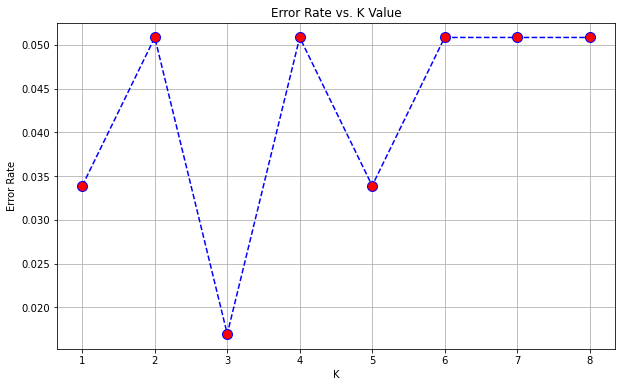

In [23]:
# Now create the following plot using the information from the for loop.

plt.figure(figsize=(10,6))
plt.grid(True)
plt.plot(range(1, 9),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='red', markersize=10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K')
plt.ylabel('Error Rate')
plt.show() 

We see 3 is the optimum value of K for error rate, beyond which error rate increases, hence we will use K = 3 as the value

### Retrain with the new K value

In [24]:
# Retrain with new optimum Value
optimum_k = error_rate.index(min(error_rate)) + 1

# We will run a Grid Search based on various parameters
from sklearn.model_selection import GridSearchCV
grid_params = {'weights':['uniform', 'distance'], 'metric':['euclidean', 'manhattan']}

knnGrid = GridSearchCV(KNeighborsClassifier(n_neighbors=optimum_k), grid_params, verbose=1, cv=10, n_jobs=-1)
knnGrid.fit(features_train, target_train)

Fitting 10 folds for each of 4 candidates, totalling 40 fits


GridSearchCV(cv=10, estimator=KNeighborsClassifier(n_neighbors=3), n_jobs=-1,
             param_grid={'metric': ['euclidean', 'manhattan'],
                         'weights': ['uniform', 'distance']},
             verbose=1)

#### To Check which Parameters gave us the best results

In [25]:
# Check thge best params
knnGrid.best_params_

{'metric': 'manhattan', 'weights': 'distance'}

In [26]:
from sklearn.metrics import confusion_matrix, classification_report, f1_score, balanced_accuracy_score, accuracy_score

predictions = knnGrid.predict(features_test)

print("Confusion Matrix - K Nearest Neighbor\n")
print(confusion_matrix(target_test,predictions))
print("\n")
print("Balanced Accuracy Score \n")
print(balanced_accuracy_score(target_test, predictions))
print("\n")
print("Accuracy Score \n")
print(accuracy_score(target_test, predictions))
print("\n")
print("F1 Score \n")
print(f1_score(target_test, predictions))
print("\n")
print("Classification Report \n")
print(classification_report(target_test,predictions))
print("\n")

Confusion Matrix - K Nearest Neighbor

[[14  1]
 [ 1 43]]


Balanced Accuracy Score 

0.9553030303030303


Accuracy Score 

0.9661016949152542


F1 Score 

0.9772727272727273


Classification Report 

              precision    recall  f1-score   support

           0       0.93      0.93      0.93        15
           1       0.98      0.98      0.98        44

    accuracy                           0.97        59
   macro avg       0.96      0.96      0.96        59
weighted avg       0.97      0.97      0.97        59



